# 📌 TUTORIAL DAS CORES

- <span style="color:white">⬜ Padrão</span>
- <span style="color:green">🟩 Topicos</span>
- <span style="color:red">🟥 Atenção</span>
- <span style="color:lightskyblue">🟦 Informação</span>
- <span style="color:yellow">🟨 Anotação</span>
 <br> 
 <br> 
 ------------
<br>

## Sobre o projeto
O nosso projeto é sobre os dados que tem no portal do CEAPS (Cota para Exercício da Atividade Parlamentar dos Senadores).
<br>
Basicamente, o CEAPS contém todos os gastos que senadores brasileiros declararam, divididos por ano.
<br>

## Os topicos são:
### 0.0 - Analises e ajustes dos dados
    -   Concatenar os CSV para trabalhar somente com um DataFrame
    -   Detalhes (Primeira impressão)
    -   Analisar os tipos dos campos (E concertar)

### 1.0 - 

# <span style="color:green"> IMPORTS</span>

In [273]:
import  pandas  as  pd
import  numpy   as  np

import  re

import  plotly              as  plt
import  plotly.offline      as  py
import  plotly.graph_objs   as  go
import  plotly.express      as  px

from    sklearn.metrics             import  mean_squared_error
from    sklearn.metrics             import  mean_absolute_percentage_error
from    math                        import  sqrt

from    prophet                     import  Prophet

from	statsmodels.tsa.seasonal    import  seasonal_decompose

### <span style="color: #b0ccb1">Importandos os dados</span>

<span style="color:#007FFF">Identificando o encoding para conseguir ler o arquivo de forma certa</span>

In [274]:
# # Tente ler o arquivo CSV usando diferentes codificações até encontrar a correta
# possible_encodings = ['utf-8', 'latin1', 'ISO-8859-1', 'cp1252']

# for encoding in possible_encodings:
#     try:
#         df_ceaps_2022 = pd.read_csv('./datasets/despesa_ceaps_2008.csv', encoding=encoding, sep=';')
#         print(f"Arquivo lido com sucesso usando a codificação: {encoding}")
#         break
#     except UnicodeDecodeError:
#         print(f"Erro ao ler o arquivo com a codificação: {encoding}")

# # Agora 'df' contém os dados do seu arquivo CSV em um DataFrame do pandas


In [275]:
# df_ceaps_2008 = pd.read_csv('./datasets/despesa_ceaps_2008.csv', encoding='ISO-8859-1', sep=';', skiprows=1, dtype={'COD_DOCUMENTO': str})
# df_ceaps_2009 = pd.read_csv('./datasets/despesa_ceaps_2009.csv', encoding='ISO-8859-1', sep=';', skiprows=1, dtype={'COD_DOCUMENTO': str})
# df_ceaps_2010 = pd.read_csv('./datasets/despesa_ceaps_2010.csv', encoding='ISO-8859-1', sep=';', skiprows=1, dtype={'COD_DOCUMENTO': str})
df_ceaps_2011 = pd.read_csv('./datasets/despesa_ceaps_2011.csv', encoding='ISO-8859-1', sep=';', skiprows=1, dtype={'COD_DOCUMENTO': str})
df_ceaps_2012 = pd.read_csv('./datasets/despesa_ceaps_2012.csv', encoding='ISO-8859-1', sep=';', skiprows=1, dtype={'COD_DOCUMENTO': str})
df_ceaps_2013 = pd.read_csv('./datasets/despesa_ceaps_2013.csv', encoding='ISO-8859-1', sep=';', skiprows=1, dtype={'COD_DOCUMENTO': str})
df_ceaps_2014 = pd.read_csv('./datasets/despesa_ceaps_2014.csv', encoding='ISO-8859-1', sep=';', skiprows=1, dtype={'COD_DOCUMENTO': str})
df_ceaps_2015 = pd.read_csv('./datasets/despesa_ceaps_2015.csv', encoding='ISO-8859-1', sep=';', skiprows=1, dtype={'COD_DOCUMENTO': str})
df_ceaps_2016 = pd.read_csv('./datasets/despesa_ceaps_2016.csv', encoding='ISO-8859-1', sep=';', skiprows=1, dtype={'COD_DOCUMENTO': str})
df_ceaps_2017 = pd.read_csv('./datasets/despesa_ceaps_2017.csv', encoding='ISO-8859-1', sep=';', skiprows=1, dtype={'COD_DOCUMENTO': str})
df_ceaps_2018 = pd.read_csv('./datasets/despesa_ceaps_2018.csv', encoding='ISO-8859-1', sep=';', skiprows=1, dtype={'COD_DOCUMENTO': str})
df_ceaps_2019 = pd.read_csv('./datasets/despesa_ceaps_2019.csv', encoding='ISO-8859-1', sep=';', skiprows=1, dtype={'COD_DOCUMENTO': str})
df_ceaps_2020 = pd.read_csv('./datasets/despesa_ceaps_2020.csv', encoding='ISO-8859-1', sep=';', skiprows=1, dtype={'COD_DOCUMENTO': str})
df_ceaps_2021 = pd.read_csv('./datasets/despesa_ceaps_2021.csv', encoding='ISO-8859-1', sep=';', skiprows=1, dtype={'COD_DOCUMENTO': str})
df_ceaps_2022 = pd.read_csv('./datasets/despesa_ceaps_2022.csv', encoding='ISO-8859-1', sep=';', skiprows=1, dtype={'COD_DOCUMENTO': str})

# <span style="color:green">FUNÇÕES</span>

In [276]:
def mape(y_true, y_pred):
    return mean_absolute_percentage_error(y_true, y_pred)

def rmse(y_true, y_pred):
    return np.sqrt(mean_squared_error(y_true, y_pred))

# <span style="color:green">0.0 Analises e ajustes dos dados</span>

### <span style="color: #b0ccb1">Concatenando os datasets</span>

In [277]:
df = pd.concat([
    # df_ceaps_2008,
    # df_ceaps_2009,
    # df_ceaps_2010,
    df_ceaps_2011,
    df_ceaps_2012,
    df_ceaps_2013,
    df_ceaps_2014,
    df_ceaps_2015,
    df_ceaps_2016,
    df_ceaps_2017,
    df_ceaps_2018,
    df_ceaps_2019,
    df_ceaps_2020,
    df_ceaps_2021,
    df_ceaps_2022
], axis=0)


### <span style="color: #b0ccb1">Detalhes (Primeira impressão)</span>
- <span style="color: yellow">Total de dados: 317963 registros</span>
- <span style="color: yellow">Faltando dados nos campos: ['CNPJ_CPF', 'FORNECEDOR', 'DOCUMENTO', 'DATA', 'DETALHAMENTO', 'COD_DOCUMENTO']</span>
- <span style="color: yellow">Tipos dos campos: 
    - ANO (int64): <span style="color: #dfdb98">O ano do cadastro✔️</span>
    - MES (int64): <span style="color: #dfdb98">O mês do cadastro ✔️</span>
    - SENADOR (object): <span style="color: #dfdb98">O nome do senador ✔️</span>
    - TIPO_DESPESA(object): <span style="color: #dfdb98">Descrição da despesa ✔️</span>
    - CNPJ_CPF(object): <span style="color: #dfdb98">CNPJ da empresa (ACHISMO) ✔️</span>
    - FORNECEDOR(object): <span style="color: #dfdb98">Nome do fornecedor ✔️</span>
    - DOCUMENTO(object): <span style="color: #dfdb98">Não entendi o valor ✔️</span>
    - DATA(object): <span style="color: #dfdb98">MUDAR DE "object" P/ "date" ❌</span>
    - DETALHAMENTO(object): <span style="color: #dfdb98">Detalhe da compra ✔️</span>
    - VALOR_REEMBOLSADO(object): <span style="color: #dfdb98">MUDAR DE "object" P/ "float" ❌</span>
    - COD_DOCUMENTO(object): <span style="color: #dfdb98"> PRIMEIRA IMPRESSÃO É SOMENTE NÚMEROS, MUDAR PARA "int64" ❌</span>
</span>


In [278]:
df.columns

Index(['ANO', 'MES', 'SENADOR', 'TIPO_DESPESA', 'CNPJ_CPF', 'FORNECEDOR',
       'DOCUMENTO', 'DATA', 'DETALHAMENTO', 'VALOR_REEMBOLSADO',
       'COD_DOCUMENTO'],
      dtype='object')

In [279]:
len(df)

280799

In [280]:
df.describe()

,ANO,MES
count,280799.000000,280799.000000
mean,2015.912172,6.603019
std,3.305664,3.315984
min,2011.000000,1.000000
25%,2013.000000,4.000000
50%,2016.000000,7.000000
75%,2018.000000,9.000000
max,2022.000000,12.000000


In [281]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 280799 entries, 0 to 16781
Data columns (total 11 columns):
 #   Column             Non-Null Count   Dtype 
---  ------             --------------   ----- 
 0   ANO                280799 non-null  int64 
 1   MES                280799 non-null  int64 
 2   SENADOR            280799 non-null  object
 3   TIPO_DESPESA       280799 non-null  object
 4   CNPJ_CPF           280799 non-null  object
 5   FORNECEDOR         280799 non-null  object
 6   DOCUMENTO          261627 non-null  object
 7   DATA               280799 non-null  object
 8   DETALHAMENTO       180631 non-null  object
 9   VALOR_REEMBOLSADO  280799 non-null  object
 10  COD_DOCUMENTO      280797 non-null  object
dtypes: int64(2), object(9)
memory usage: 25.7+ MB


In [282]:
df.dtypes

ANO                   int64
MES                   int64
SENADOR              object
TIPO_DESPESA         object
CNPJ_CPF             object
FORNECEDOR           object
DOCUMENTO            object
DATA                 object
DETALHAMENTO         object
VALOR_REEMBOLSADO    object
COD_DOCUMENTO        object
dtype: object

In [283]:
df.tail()

,ANO,MES,SENADOR,TIPO_DESPESA,CNPJ_CPF,FORNECEDOR,DOCUMENTO,DATA,DETALHAMENTO,VALOR_REEMBOLSADO,COD_DOCUMENTO
16777,2022,12,ZEQUINHA MARINHO,"Passagens aéreas, aquáticas e terrestres nacio...",22.052.777/0001-32,Exceller Tour,WIXHAI,06/12/2022,"Companhia Aérea: LATAM, Localizador: WIXHAI. P...","2893,04",2191398
16778,2022,12,ZEQUINHA MARINHO,"Passagens aéreas, aquáticas e terrestres nacio...",22.052.777/0001-32,Exceller Tour,WITOLM,09/12/2022,"Companhia Aérea: GOL, Localizador: WITOLM. Pas...","1180,19",2192272
16779,2022,12,ZEQUINHA MARINHO,"Passagens aéreas, aquáticas e terrestres nacio...",22.052.777/0001-32,Exceller Tour,THPKVQ,20/12/2022,"Companhia Aérea: TAM, Localizador: THPKVQ. Pas...","2671,9",2192274
16780,2022,12,ZEQUINHA MARINHO,"Passagens aéreas, aquáticas e terrestres nacio...",22.052.777/0001-32,Exceller Tour,QNN9HX,21/12/2022,"Companhia Aérea: AZUL, Localizador: QNN9HX. Pa...","1334,31",2192244
16781,2022,12,ZEQUINHA MARINHO,"Passagens aéreas, aquáticas e terrestres nacio...",22.052.777/0001-32,Exceller Tour,WMQWBX,30/12/2022,"Companhia Aérea: TAM, Localizador: WMQWBX. Pas...","2250,72",2193622


### <span style="color: #b0ccb1">Analisar campos</span>

##### <span style="color: #b0ccb1">Arrumar tipos de campos</span>

<span style="color:lightskyblue">Ajustar os campos para melhorar as analises</span>

In [284]:
# Novo campo ['NUM_CARCTERS_COD_DOCUMENTO'] quantidade de caracteres no campo COD_DOCUMENTO
df['NUM_CARCTERS_COD_DOCUMENTO']    =   df['COD_DOCUMENTO'].astype(str).str.len()

# ANO + '_' + MES
df['ANO_MES']                       =    pd.to_datetime(df['ANO'].astype(str) + '-' + df['MES'].astype(str), format='%Y-%m')

# COD_DOCUMENTO P/ float64
df['COD_DOCUMENTO']                 =   df['COD_DOCUMENTO'].astype('float64')

# Trocando "," por "." tirando os valore "\r\n" e TIPO P/ float
df['VALOR_REEMBOLSADO']             =   df['VALOR_REEMBOLSADO'].str.replace(',', '.')
df['VALOR_REEMBOLSADO']             =   df['VALOR_REEMBOLSADO'].str.replace('\r\n', '').astype('float64')

# DATA P/ date
df['DATA_FORMAT']                   =   pd.to_datetime(df['DATA'], format='%d/%m/%Y', errors='coerce')

# REMOVENDO ['VALOR_REEMBOLSADO'] < 0
df                                  =   df[df['VALOR_REEMBOLSADO'] > 0]

# TIPO_DESPESA Abreviada
df['CATEGORIA_ABREVIADA']           =   df['TIPO_DESPESA'].str[:15] + '...'


In [285]:
df.dtypes

ANO                                    int64
MES                                    int64
SENADOR                               object
TIPO_DESPESA                          object
CNPJ_CPF                              object
FORNECEDOR                            object
DOCUMENTO                             object
DATA                                  object
DETALHAMENTO                          object
VALOR_REEMBOLSADO                    float64
COD_DOCUMENTO                        float64
NUM_CARCTERS_COD_DOCUMENTO             int64
ANO_MES                       datetime64[ns]
DATA_FORMAT                   datetime64[ns]
CATEGORIA_ABREVIADA                   object
dtype: object

In [286]:
df.tail()

,ANO,MES,SENADOR,TIPO_DESPESA,CNPJ_CPF,FORNECEDOR,DOCUMENTO,DATA,DETALHAMENTO,VALOR_REEMBOLSADO,COD_DOCUMENTO,NUM_CARCTERS_COD_DOCUMENTO,ANO_MES,DATA_FORMAT,CATEGORIA_ABREVIADA
16777,2022,12,ZEQUINHA MARINHO,"Passagens aéreas, aquáticas e terrestres nacio...",22.052.777/0001-32,Exceller Tour,WIXHAI,06/12/2022,"Companhia Aérea: LATAM, Localizador: WIXHAI. P...",2893.04,2191398.0,7,2022-12-01,2022-12-06,Passagens aérea...
16778,2022,12,ZEQUINHA MARINHO,"Passagens aéreas, aquáticas e terrestres nacio...",22.052.777/0001-32,Exceller Tour,WITOLM,09/12/2022,"Companhia Aérea: GOL, Localizador: WITOLM. Pas...",1180.19,2192272.0,7,2022-12-01,2022-12-09,Passagens aérea...
16779,2022,12,ZEQUINHA MARINHO,"Passagens aéreas, aquáticas e terrestres nacio...",22.052.777/0001-32,Exceller Tour,THPKVQ,20/12/2022,"Companhia Aérea: TAM, Localizador: THPKVQ. Pas...",2671.90,2192274.0,7,2022-12-01,2022-12-20,Passagens aérea...
16780,2022,12,ZEQUINHA MARINHO,"Passagens aéreas, aquáticas e terrestres nacio...",22.052.777/0001-32,Exceller Tour,QNN9HX,21/12/2022,"Companhia Aérea: AZUL, Localizador: QNN9HX. Pa...",1334.31,2192244.0,7,2022-12-01,2022-12-21,Passagens aérea...
16781,2022,12,ZEQUINHA MARINHO,"Passagens aéreas, aquáticas e terrestres nacio...",22.052.777/0001-32,Exceller Tour,WMQWBX,30/12/2022,"Companhia Aérea: TAM, Localizador: WMQWBX. Pas...",2250.72,2193622.0,7,2022-12-01,2022-12-30,Passagens aérea...


<hr>

##### <span style="color: #b0ccb1">Campo: CNPJ_CPF</span>

- <span style="color: yellow">3144 dos dados estão com os valores nulos</span>
- <span style="color: yellow">Valores nulos de 2008-02 até 2009-03</span>
- <span style="color: yellow">Os valores começam a ser preenchidos em 2009-04</span>

<span style="color:red"> Não vamos deletar o campo, nem apagar as linhas. <b>Por enquanto!</b></span>
<br>
<span style="color:red">Acredito que tenham colocado esse campo depois da data 2009-03.</span>
<br>
<span style="color:red"><b>Preencher com "00000000000"</b></span>

In [287]:
len(df[df['CNPJ_CPF'].isnull()]), len(df[df['CNPJ_CPF'].notna()])

(0, 280796)

<span style="color:lightskyblue">Min. e Max dos valores NULL</span>

In [288]:
df[df['CNPJ_CPF'].isnull()]['ANO_MES'].min(), df[df['CNPJ_CPF'].isnull()]['ANO_MES'].max()

(NaT, NaT)

<span style="color:lightskyblue">Min. e Max dos valores não NULL</span>

In [289]:
df[df['CNPJ_CPF'].notna()]['ANO_MES'].min(), df[df['CNPJ_CPF'].notna()]['ANO_MES'].max()

(Timestamp('2011-01-01 00:00:00'), Timestamp('2022-12-01 00:00:00'))

In [290]:
df['CNPJ_CPF'].fillna(00000000000, inplace=True)

C:\Users\ferna\AppData\Local\Temp\ipykernel_11128\2515421642.py:1: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.





<hr>

##### <span style="color: #b0ccb1">Campos: FORNECEDOR</span>

- <span style="color: yellow">3144 dos dados estão com os valores nulos</span>
- <span style="color: yellow">Valores nulos de 2008-02 até 2009-03</span>
- <span style="color: yellow">Os valores começam a ser preenchidos em 2009-04</span>

<span style="color:red">Não vamos deletar o campo, nem apagar as linhas. <b>Por enquanto!</b></span>
<br>
<span style="color:red">Preenche com <b>"FORNECEDOR NÃO CADASTRADO"</b></span>

In [291]:
len(df[df['FORNECEDOR'].isna()])

0

<span style="color:lightskyblue">Min. e Max dos valores NULL</span>

In [292]:
df[df['FORNECEDOR'].isnull()]['ANO_MES'].min(), df[df['FORNECEDOR'].isnull()]['ANO_MES'].max()

(NaT, NaT)

<span style="color:lightskyblue">Min. e Max dos valores não NULL</span>

In [293]:
df[df['FORNECEDOR'].notna()]['ANO_MES'].min(), df[df['FORNECEDOR'].notna()]['ANO_MES'].max()

(Timestamp('2011-01-01 00:00:00'), Timestamp('2022-12-01 00:00:00'))

In [294]:
df['FORNECEDOR'].fillna('FORNECEDOR NÃO CADASTRADO', inplace=True)

C:\Users\ferna\AppData\Local\Temp\ipykernel_11128\2007456774.py:1: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.





<hr>

##### <span style="color: #b0ccb1">Campos: DOCUMENTO</span>

- <span style="color:yellow">24810 dos dados estão com os valores nulos</span>
- <span style="color:yellow">221607 valores unicos</span>
- <span style="color:yellow"><b>NULOS</b> de 2008-02 até 2009-03, <b>mas ainda tem valores nulos depois dessa data</b></span>
- <span style="color:yellow">NUM_CARCTERS_COD_DOCUMENTO > 7 o DOCUMENTO é tudo NULL, <b> tem valores nulos com 6 e 7 caracteres</b></span>
<br><br>
<span style="color:red">NUM_CARCTERS_COD_DOCUMENTO < 6 pode deletar</span>
<br>
<span style="color:red">NUM_CARCTERS_COD_DOCUMENTO > 7 inserir valor <b>'NÃO PREENCHIDO'</b></span>

<span style="color: lightskyblue">Vendo se tem NUM_LETRAS_COD_DOCUMENTO > 8 na epoca que não tinha dados</span>

In [295]:
len(df.loc[( (df['ANO_MES'] < '2009-04-01') & (df['NUM_CARCTERS_COD_DOCUMENTO'] > 8) )]), len( df.loc[df['ANO_MES'] < '2009-04-01' ] )

(0, 0)

In [296]:
len(df[df['DOCUMENTO'].isna()]), len(df[df['DOCUMENTO'].notna()])

(19171, 261625)

In [297]:
print("Nulos")
df[df['DOCUMENTO'].isnull()]['ANO_MES'].min(), df[df['DOCUMENTO'].isnull()]['ANO_MES'].max()

Nulos


(Timestamp('2011-01-01 00:00:00'), Timestamp('2022-12-01 00:00:00'))

In [298]:
print("Não nulos")
df[df['DOCUMENTO'].notna()]['ANO_MES'].min(), df[df['DOCUMENTO'].notna()]['ANO_MES'].max()

Não nulos


(Timestamp('2011-01-01 00:00:00'), Timestamp('2022-12-01 00:00:00'))

In [299]:
print("Valores não NULOS, min e max: {} e {}".format(df[(df['DOCUMENTO'].notna())]['NUM_CARCTERS_COD_DOCUMENTO'].min(), df[(df['DOCUMENTO'].notna())]['NUM_CARCTERS_COD_DOCUMENTO'].max()))

Valores não NULOS, min e max: 3 e 7


In [300]:
print("Valores NULOS, min e max: {} e {}".format(df[(df['DOCUMENTO'].isnull())]['NUM_CARCTERS_COD_DOCUMENTO'].min(), df[(df['DOCUMENTO'].isnull())]['NUM_CARCTERS_COD_DOCUMENTO'].max()))

Valores NULOS, min e max: 6 e 7


<span style="color: lightskyblue">DELETA NUM_LETRAS_COD_DOCUMENTO < 5</span>

In [301]:
# Criar uma máscara booleana para identificar as linhas onde 'NUM_CARCTERS_COD_DOCUMENTO' seja menor que 5
mascara = df['NUM_CARCTERS_COD_DOCUMENTO'] < 5

# Usar a máscara para selecionar as linhas que não atendem ao critério e deletá-las do DataFrame
df = df[~mascara]

<span style="color: lightskyblue">NULOS & NUM_CARCTERS_COD_DOCUMENTO > 7 inserir valor <b>'NÃO PREENCHIDO'</b></span>

In [302]:
mascara = (df['DOCUMENTO'].isnull()) & (df['NUM_CARCTERS_COD_DOCUMENTO'] > 7)
df.loc[mascara, 'DOCUMENTO'] = 'NÃO PREENCHIDO'

<span style="color: lightskyblue">NULOS & NUM_CARCTERS_COD_DOCUMENTO < 8 inserir valor <b>'POSSIVEL PREENCHIMENTO'</b></span>

In [303]:
mascara = (df['DOCUMENTO'].isnull()) & (df['NUM_CARCTERS_COD_DOCUMENTO'] < 8)
df.loc[mascara, 'DOCUMENTO'] = 'POSSIVEL PREENCHIMENTO'

<hr>

##### <span style="color: #b0ccb1">Campos: DATA</span>

- <span style="color:yellow">3144 dados nulos</span>
- <span style="color:yellow">Valores nulos de 2008-02 até 2009-03</span>
- <span style="color:yellow">Os valores começam a ser preenchidos em 2009-04</span>
- <span style="color:yellow">Identificamos que tem DATA que são as mesma do ANO_MES, <b>mas algumas não</b></span>
<br><br>
<span style="color:red">Colocar as data faltantes como ANO/MES</span>


In [304]:
len(df[df['DATA'].isnull()])

0

In [305]:
print('NULOS')
df[df['DATA'].isnull()]['ANO_MES'].min(), df[df['DATA'].isnull()]['ANO_MES'].max()

NULOS


(NaT, NaT)

In [306]:
print('NÃO NULOS')
df[df['DATA'].notna()]['ANO_MES'].min(), df[df['DATA'].notna()]['ANO_MES'].max()

NÃO NULOS


(Timestamp('2011-01-01 00:00:00'), Timestamp('2022-12-01 00:00:00'))

In [307]:
df.tail(1)

,ANO,MES,SENADOR,TIPO_DESPESA,CNPJ_CPF,FORNECEDOR,DOCUMENTO,DATA,DETALHAMENTO,VALOR_REEMBOLSADO,COD_DOCUMENTO,NUM_CARCTERS_COD_DOCUMENTO,ANO_MES,DATA_FORMAT,CATEGORIA_ABREVIADA
16781,2022,12,ZEQUINHA MARINHO,"Passagens aéreas, aquáticas e terrestres nacio...",22.052.777/0001-32,Exceller Tour,WMQWBX,30/12/2022,"Companhia Aérea: TAM, Localizador: WMQWBX. Pas...",2250.72,2193622.0,7,2022-12-01,2022-12-30,Passagens aérea...


In [308]:
# df['DATA_FORMAT'] = df.apply(lambda x: pd.to_datetime(x['ANO_MES']) if pd.isnull(x['DATA_FORMAT']) else x['DATA_FORMAT'], axis=1)
len(df[df['DATA_FORMAT'].isnull()])


21

<hr>

##### <span style="color: #b0ccb1">Campos: DETALHAMENTO</span>

- <span style="color:yellow">137332 dados nulos</span>
- <span style="color:yellow"><b>NÃO NULOS</b> apartir 2011-04-01</span>
- <span style="color:yellow">Tem valores NULOS depois da data 2011-04-01</span>
<br><br>
<span style="color:red">Analisar melhor</span>


In [309]:
print("NULLs {} | Não NULLS {}".format(len(df[df['DETALHAMENTO'].isnull()]), len(df[df['DETALHAMENTO'].notnull()])))

NULLs 100168 | Não NULLS 180626


In [310]:
print("Valore únicos: {}".format(len(df['DETALHAMENTO'].unique())))

Valore únicos: 108498


In [311]:
print('NULOS')
df[df['DETALHAMENTO'].isnull()]['ANO_MES'].min(), df[df['DETALHAMENTO'].isnull()]['ANO_MES'].max()

NULOS


(Timestamp('2011-01-01 00:00:00'), Timestamp('2022-12-01 00:00:00'))

In [312]:
print('NÃO NULOS')
df[df['DETALHAMENTO'].notna()]['ANO_MES'].min(), df[df['DETALHAMENTO'].notna()]['ANO_MES'].max()

NÃO NULOS


(Timestamp('2011-04-01 00:00:00'), Timestamp('2022-12-01 00:00:00'))

<hr>

##### <span style="color: #b0ccb1">Campos: COD_DOCUMENTO</span>

- <span style="color:yellow">2 dados nulos</span>
- <span style="color:yellow">Dados NULLs estava com problema no CSV</span>
<br><br>
<span style="color:red"><b>Deletar</b> os dados NULLs</span>


In [313]:
print("Valores NULLs: {}".format(len(df[df['COD_DOCUMENTO'].isnull()])))

Valores NULLs: 0


In [314]:
print("Valores não NULLs: {}".format(len(df[df['COD_DOCUMENTO'].notnull()])))

Valores não NULLs: 280794


##### <hr>

### <span style="color: #b0ccb1">Graficos</span>
<span style="color:lightskyblue">Perguntas:</span>
-   <span style="color:lightskyblue">Cada ano que passa, as despesas são maiores pelo inflação?</span>
    -   <i style="color:lightskyblue">NÃO! Não deu tanta diferença nos valores</i> 
-   <span style="color:lightskyblue">Dezembro os gastos são <b>maior</b>, por ser final de ano e muitas vezes os governos são trocados?</span>
    -   <i style="color:lightskyblue">SIM!</i> 
-   <span style="color:lightskyblue">Janeiro os gastos são <b>menores</b>, estão de ferias e muitas vezes os governos são trocados?</span>
    -   <i style="color:lightskyblue">SIM, mas na média o mês de Jan é o 3° maior</i>
-   <span style="color:lightskyblue">TIPO = Gastos com meteriais serão os menores?</span>
    -   <i style="color:lightskyblue">SIM!</i>
-   <span style="color:lightskyblue">TIPO = Segurança menor?</span>
    -   <i style="color:lightskyblue">SIM, é o menos de todos. Porém a média dele é uma das mais caras.</i>

<hr>

-   <span style="color:yellow">Ano 2008 tem a maior média <b>(Estranho)</b>.</span>
-   <span style="color:yellow">O menor mês de GASTOS é Jan. Mas se tratando de media fica em 3°</span>
-   <span style="color:yellow">O maior mês de GASTOS é Dez.</span>
-   <span style="color:yellow">TIPO 'Locomoção, hospedagem, alimentação, combustíveis e lubrificantes' foi o que mais gastaram, porém em média é um dos menores valores.</span>
-   <span style="color:yellow">'Serviços de Segurança Privada, foi o que menos gastaram, mas o MÉDIA é muito alta</span>
-   <span style="color:yellow">Contratação de consultorias, assessorias, pesquisas, trabalhos técnicos e outros serviços de apoio ao exercício do mandato parlamentar, é o que mais vem crescendo os gastos, porém tem picos.</span>
-   <span style="color:yellow">O maior mês de GASTOS é Dez.</span>



In [315]:
df.columns

Index(['ANO', 'MES', 'SENADOR', 'TIPO_DESPESA', 'CNPJ_CPF', 'FORNECEDOR',
       'DOCUMENTO', 'DATA', 'DETALHAMENTO', 'VALOR_REEMBOLSADO',
       'COD_DOCUMENTO', 'NUM_CARCTERS_COD_DOCUMENTO', 'ANO_MES', 'DATA_FORMAT',
       'CATEGORIA_ABREVIADA'],
      dtype='object')

In [316]:
print("SENADOR QTD UNIQUE: {}".format(len(df['FORNECEDOR'].unique())))
print("TIPO_DESPESA QTD UNIQUE: {}".format(len(df['TIPO_DESPESA'].unique())))
print("CNPJ_CPF QTD UNIQUE: {}".format(len(df['CNPJ_CPF'].unique())))
print("COD_DOCUMENTO QTD UNIQUE: {}".format(len(df['COD_DOCUMENTO'].unique())))
print("ANO_MES QTD UNIQUE: {}".format(len(df['ANO_MES'].unique())))

SENADOR QTD UNIQUE: 43946
TIPO_DESPESA QTD UNIQUE: 7
CNPJ_CPF QTD UNIQUE: 23003
COD_DOCUMENTO QTD UNIQUE: 280794
ANO_MES QTD UNIQUE: 144


#### <span style="color: #b0ccb1">VALOR_REEMBOLSADO</span>

##### <span style="color:#b0ccb1">Com ['ANO_MES']</span>

In [317]:
df_valor_reembolsado            =   df[['ANO_MES', 'VALOR_REEMBOLSADO']].groupby('ANO_MES').agg({'sum', 'mean'}).reset_index().sort_values('ANO_MES', ascending=True)
df_valor_reembolsado.columns    =   ['ANO_MES', 'SOMA', 'MEDIA']

In [318]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=df_valor_reembolsado['ANO_MES'], y=df_valor_reembolsado['SOMA'],
                    mode='lines+markers',
                    name='lines+markers'))
fig.show()

In [319]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=df_valor_reembolsado['ANO_MES'], y=df_valor_reembolsado['MEDIA'],
                    mode='lines+markers',
                    name='lines+markers'))

fig.show()

In [320]:
fig = px.line(df_valor_reembolsado, x='ANO_MES', y="SOMA")
fig.show()

In [321]:
df_mes          =   df[['MES', 'VALOR_REEMBOLSADO']].groupby('MES').agg({'mean', 'sum'}).reset_index().sort_values('MES', ascending=True)
df_mes.columns  =   ['MES', 'SOMA', 'MÉDIA']

In [322]:
df_mes['MES']   =   df_mes['MES'].map({1: 'Jan', 2: 'Fev', 3: 'Mar', 4: 'Abr', 5: 'Mai', 6: 'Jun', 7: 'Jul', 8: 'Ago', 9: 'Set', 10: 'Out', 11: 'Nov', 12: 'Dez', })

In [323]:
fig = px.line(df_mes, x='MES', y="SOMA")
fig.show()

In [324]:
fig = px.line(df_mes, x='MES', y="MÉDIA")
fig.show()

In [325]:
df_ano          =   df[['ANO', 'VALOR_REEMBOLSADO']].groupby('ANO').agg({'mean', 'sum', 'count', 'median'}).reset_index().sort_values('ANO', ascending=True)
df_ano.columns  =   ['ANO', 'MEDIANA', 'QTD', 'SOMA', 'MÉDIA']
df_ano

,ANO,MEDIANA,QTD,SOMA,MÉDIA
0,2011,188.500,25574,19004502.48,743.118107
1,2012,234.740,30175,23354742.37,773.976549
2,2013,289.520,29376,24658952.86,839.425138
3,2014,367.420,22002,22519394.12,1023.515777
4,2015,335.705,26052,24860827.61,954.277123
5,2016,323.125,26768,25301959.82,945.231613
6,2017,302.135,27022,26673083.66,987.087694
7,2018,287.200,24492,25604701.33,1045.431215
8,2019,345.995,21634,25248242.40,1167.063067
9,2020,389.925,14090,20414923.60,1448.894507


In [326]:
fig = px.line(df_ano, x='ANO', y="SOMA")
fig.show()

In [327]:
# fig = px.box(df, y="VALOR_REEMBOLSADO")
fig = px.box(df, x="ANO", y="VALOR_REEMBOLSADO")
fig.show()


In [328]:
# fig = px.scatter(data=df, x='ANO', y='VALOR_REEMBOLSADO', hue='ANO')
fig = px.scatter(df, x='ANO_MES', y='VALOR_REEMBOLSADO')

fig.show()

##### <span style="color:#b0ccb1">Com ['TIPO_DESPESA']</span>

In [329]:
df['TIPO_DESPESA'].unique()

array(['Aluguel de imóveis para escritório político, compreendendo despesas concernentes a eles.',
       'Aquisição de material de consumo para uso no escritório político, inclusive aquisição ou locação de software, despesas postais, aquisição de publicações, locação de móveis e de equipamentos. ',
       'Divulgação da atividade parlamentar',
       'Locomoção, hospedagem, alimentação, combustíveis e lubrificantes',
       'Passagens aéreas, aquáticas e terrestres nacionais',
       'Contratação de consultorias, assessorias, pesquisas, trabalhos técnicos e outros serviços de apoio ao exercício do mandato parlamentar',
       'Serviços de Segurança Privada'], dtype=object)

In [330]:
df_tipo_despesa             =   df[['CATEGORIA_ABREVIADA', 'VALOR_REEMBOLSADO']].groupby('CATEGORIA_ABREVIADA').agg({'sum', 'count', 'median', 'mean', 'max', 'min'}).reset_index().sort_values('CATEGORIA_ABREVIADA', ascending=True)
df_tipo_despesa.columns     =   ['CATEGORIA_ABREVIADA', 'MEDIANA', 'SOMA', 'QTD', 'MAX', 'MÉDIA', 'MIN']


In [331]:
fig = px.bar(x=df_tipo_despesa['CATEGORIA_ABREVIADA'], y=df_tipo_despesa['SOMA'])
fig.show()

In [332]:
fig = px.bar(x=df_tipo_despesa['CATEGORIA_ABREVIADA'], y=df_tipo_despesa['MÉDIA'])
fig.show()

In [333]:
fig = px.box(df, x="CATEGORIA_ABREVIADA", y="VALOR_REEMBOLSADO")
fig.show() 

##### <span style="color:#b0ccb1">Com ['TIPO_DESPESA'] & ['AN_MES']</span>

In [334]:
df['TIPO_DESPESA'].unique()

array(['Aluguel de imóveis para escritório político, compreendendo despesas concernentes a eles.',
       'Aquisição de material de consumo para uso no escritório político, inclusive aquisição ou locação de software, despesas postais, aquisição de publicações, locação de móveis e de equipamentos. ',
       'Divulgação da atividade parlamentar',
       'Locomoção, hospedagem, alimentação, combustíveis e lubrificantes',
       'Passagens aéreas, aquáticas e terrestres nacionais',
       'Contratação de consultorias, assessorias, pesquisas, trabalhos técnicos e outros serviços de apoio ao exercício do mandato parlamentar',
       'Serviços de Segurança Privada'], dtype=object)

In [335]:
df_tipo_despesa             =   df[['CATEGORIA_ABREVIADA', 'VALOR_REEMBOLSADO', 'ANO_MES']].groupby(['CATEGORIA_ABREVIADA', 'ANO_MES']).agg({'sum', 'count', 'median', 'mean', 'max', 'min'}).reset_index().sort_values('CATEGORIA_ABREVIADA', ascending=True)
df_tipo_despesa             =   df_tipo_despesa.sort_values('ANO_MES')
df_tipo_despesa.columns     =   ['CATEGORIA_ABREVIADA', 'ANO_MES', 'MEDIA', 'SOMA', 'QTD', 'MAX', 'MEDIANA', 'MIN']

In [336]:
fig = px.line(df_tipo_despesa, x='ANO_MES', y='SOMA', color='CATEGORIA_ABREVIADA')
fig.show()

##### <span style="color:#b0ccb1">Com ['DATA_FORMAT']</span>

In [337]:
df_aux  =   df[['DATA_FORMAT', 'VALOR_REEMBOLSADO', 'CATEGORIA_ABREVIADA']].groupby(['DATA_FORMAT', 'CATEGORIA_ABREVIADA']).sum().reset_index()
df_aux  =   df_aux[(df_aux['DATA_FORMAT'] < pd.to_datetime('01/12/2021', format='%d/%m/%Y')) & (df_aux['DATA_FORMAT'] > pd.to_datetime('01/01/2012', format='%d/%m/%Y'))]

df_aux.head()

,DATA_FORMAT,CATEGORIA_ABREVIADA,VALOR_REEMBOLSADO
1895,2012-01-02,Aluguel de imóv...,19156.45
1896,2012-01-02,Aquisição de ma...,3627.85
1897,2012-01-02,Contratação de ...,3104.58
1898,2012-01-02,Divulgação da a...,3551.00
1899,2012-01-02,"Locomoção, hosp...",17043.45


In [338]:
fig = px.line(df_aux, x='DATA_FORMAT', y='VALOR_REEMBOLSADO', color='CATEGORIA_ABREVIADA')
fig.show()

# <span style="color:green">1.0 Modelos</span>

In [339]:
df  =   df[~df['DATA_FORMAT'].isnull()]
df  =   df[(df['DATA_FORMAT'] < pd.to_datetime('01/12/2021', format='%d/%m/%Y')) & (df['DATA_FORMAT'] > pd.to_datetime('01/01/2012', format='%d/%m/%Y'))]

### <span style="color: #b0ccb1">Tirando os campos que não fazem sentidos</span>

<span style="color:yellow"><b>Vamos tirar os campos:</b></span>
-   <span style="color:yellow">SENADOR</span>
-   <span style="color:yellow">TIPO_DESPESA</span>
-   <span style="color:yellow">CNPJ_CPF</span>
-   <span style="color:yellow">FORNECEDOR</span>
-   <span style="color:yellow">DOCUMENTO</span>
-   <span style="color:yellow">DATA</span>
-   <span style="color:yellow">DETALHAMENTO</span>
-   <span style="color:yellow">COD_DOCUMENTO</span>
-   <span style="color:yellow">NUM_CARCTERS_COD_DOCUMENTO</span>
-   <span style="color:yellow">DATA_FORMAT</span>
-   <span style="color:yellow">CATEGORIA_ABREVIADA</span>


In [340]:
df_1            =   df[['DATA_FORMAT', 'VALOR_REEMBOLSADO']].groupby('DATA_FORMAT').agg({'sum', 'count'}).reset_index()
df_1.columns    =   ['ds', 'qtd', 'y']
df_1            =   df_1.sort_values('ds')
df_1

,ds,qtd,y
0,2012-01-02,68,53128.44
1,2012-01-03,32,27088.53
2,2012-01-04,49,49486.46
3,2012-01-05,55,90185.68
4,2012-01-06,42,14339.28
...,...,...,...
3616,2021-11-26,57,88502.37
3617,2021-11-27,23,18990.41
3618,2021-11-28,17,16481.69
3619,2021-11-29,71,134779.38


In [341]:
# df_1            =   df[['DATA_FORMAT', 'VALOR_REEMBOLSADO']].groupby('DATA_FORMAT').sum().reset_index()
# df_1.columns    =   ['ds', 'sum']
# df_1            =   df_1.sort_values('ds')

In [342]:
# # Criar novas colunas com os valores das colunas originais deslocadas para cima
df_1['y_ontem']     =   df_1['y'].shift(1)
df_1['qtd_ontem']   =   df_1['qtd'].shift(1)

In [354]:
df_1    =   df_1.dropna()
df_1

,ds,qtd,y,y_ontem,qtd_ontem
1,2012-01-03,32,27088.53,53128.44,68.0
2,2012-01-04,49,49486.46,27088.53,32.0
3,2012-01-05,55,90185.68,49486.46,49.0
4,2012-01-06,42,14339.28,90185.68,55.0
5,2012-01-07,21,10755.88,14339.28,42.0
...,...,...,...,...,...
3616,2021-11-26,57,88502.37,110304.68,56.0
3617,2021-11-27,23,18990.41,88502.37,57.0
3618,2021-11-28,17,16481.69,18990.41,23.0
3619,2021-11-29,71,134779.38,16481.69,17.0


In [344]:
# df_1_aux    =   df_1.set_index('ds')
# df_1_aux['sum']

#### <span style="color: #b0ccb1">SEASONAL</span>

##### <span style="color: #b0ccb1">Gráficos</span>

<Axes: xlabel='ds'>

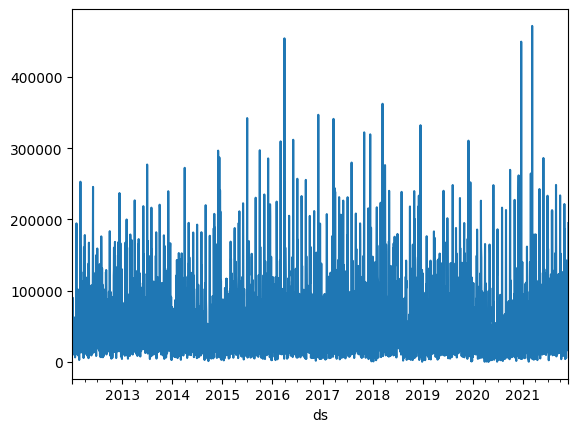

In [345]:
df_1_aux['sum'].plot()

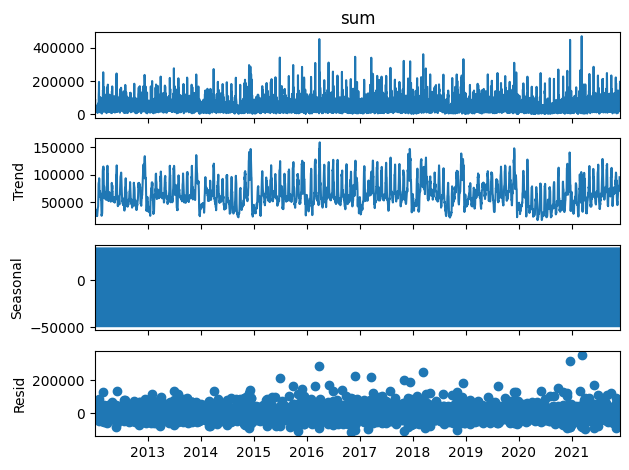

In [346]:
resultado   =   seasonal_decompose(df_1_aux['sum'])
fig         =   resultado.plot()

##### <span style="color: #b0ccb1">Teste de estacionariedade</span>

In [347]:
from    statsmodels.tsa.stattools   import  adfuller

resultado   =   adfuller(df_1_aux['sum'].dropna())

print(f'Teste ADF: {resultado[0]}')
print(f'p-valor: {resultado[1]}')


Teste ADF: -6.83914941095421
p-valor: 1.8099303662984044e-09


In [348]:
resultado   =   adfuller(df_1_aux['sum'].diff().dropna())

print(f'Teste ADF: {resultado[0]}')
print(f'p-valor: {resultado[1]}')


Teste ADF: -26.808274567731438
p-valor: 0.0


### <span style="color: #b0ccb1">Modelo</span>


In [356]:
df_1                =   df_1.sort_values('ds')
df_1_train          =   df_1[(df_1['ds'] < pd.to_datetime('01/01/2021', format='%d/%m/%Y'))]
df_1_valid          =   df_1[~(df_1['ds'] < pd.to_datetime('01/01/2021', format='%d/%m/%Y'))]
df_1_train.head()

,ds,qtd,y,y_ontem,qtd_ontem
1,2012-01-03,32,27088.53,53128.44,68.0
2,2012-01-04,49,49486.46,27088.53,32.0
3,2012-01-05,55,90185.68,49486.46,49.0
4,2012-01-06,42,14339.28,90185.68,55.0
5,2012-01-07,21,10755.88,14339.28,42.0


In [357]:
# Python
m = Prophet()
m.fit(df_1_train)

16:43:04 - cmdstanpy - INFO - Chain [1] start processing


16:43:05 - cmdstanpy - INFO - Chain [1] done processing


In [358]:
# Python
future = m.make_future_dataframe(periods=10)

In [360]:
df_1_valid[df_1_valid['ds'] == '2021-01-10']
# df_1_test[df_1_test['y'] < 1000]

,ds,qtd,y,y_ontem,qtd_ontem
3296,2021-01-10,14,9001.87,17220.64,24.0


In [365]:
# Python
forecast = m.predict(future)

In [379]:
test_forecast   =   forecast[['ds', 'yhat']].tail(10)

In [378]:
df_1_valid['y'].head(10)

3287    27606.83
3288     5863.44
3289    27748.23
3290    95550.55
3291    93501.98
3292    29808.47
3293    43317.35
3294    31094.24
3295    17220.64
3296     9001.87
Name: y, dtype: float64

In [383]:
test_forecast['y_real'] =   df_1_valid['y'].head(10)
test_forecast

,ds,yhat,y_real
3286,2021-01-01,26272.901689,NaN
3287,2021-01-02,-25327.048167,27606.83
3288,2021-01-03,-29540.844649,5863.44
3289,2021-01-04,52573.281698,27748.23
3290,2021-01-05,40008.713616,95550.55
3291,2021-01-06,38100.760389,93501.98
3292,2021-01-07,34929.093167,29808.47
3293,2021-01-08,24519.944620,43317.35
3294,2021-01-09,-24272.547514,31094.24
3295,2021-01-10,-25851.178641,17220.64


In [ ]:
# Calcular MAPE
mape_value = mape(df_1_valid['y'].head(10), forecast['yhat'].tail(10))

# Calcular RMSE
rmse_value = rmse(df_1_valid['y'].head(10), forecast['yhat'].tail(10))


# Calcular MAPE
mape_value = mape(df_1_valid['y'].head(10), forecast['yhat'].tail(10))

# Calcular RMSE
rmse_value = rmse(df_1_valid['y'].head(10), forecast['yhat'].tail(10))

print("MAPE:", mape_value)
print("RMSE:", rmse_value)


MAPE: 1.5372058544043827
RMSE: 34686.09196623322


d:\Alura\Desafio7Dias\.venv\Lib\site-packages\prophet\plot.py:72: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

d:\Alura\Desafio7Dias\.venv\Lib\site-packages\prophet\plot.py:73: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



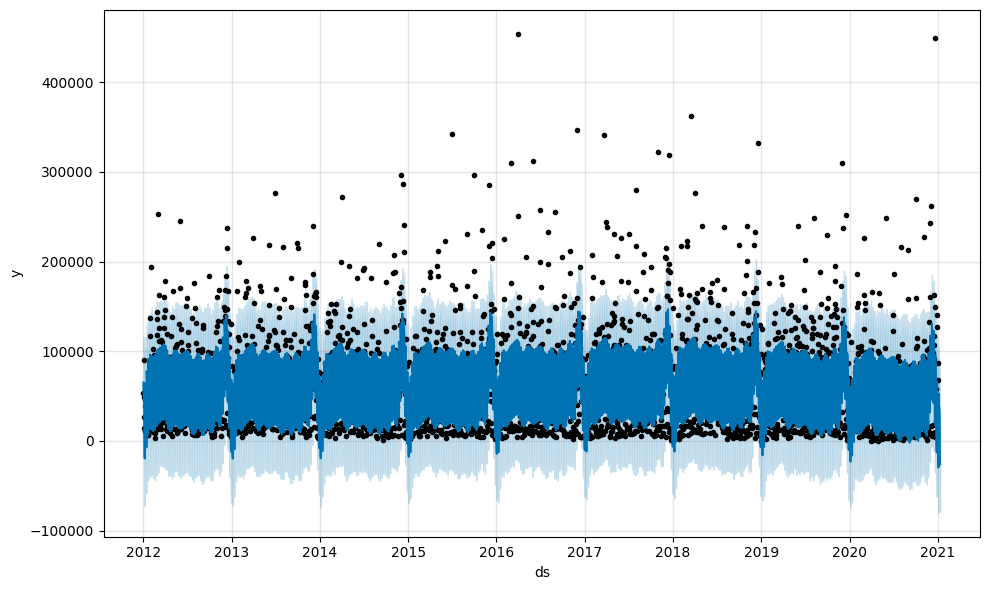

In [ ]:
# Python
fig1 = m.plot(forecast)

d:\Alura\Desafio7Dias\.venv\Lib\site-packages\prophet\plot.py:228: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

d:\Alura\Desafio7Dias\.venv\Lib\site-packages\prophet\plot.py:351: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

d:\Alura\Desafio7Dias\.venv\Lib\site-packages\prophet\plot.py:354: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



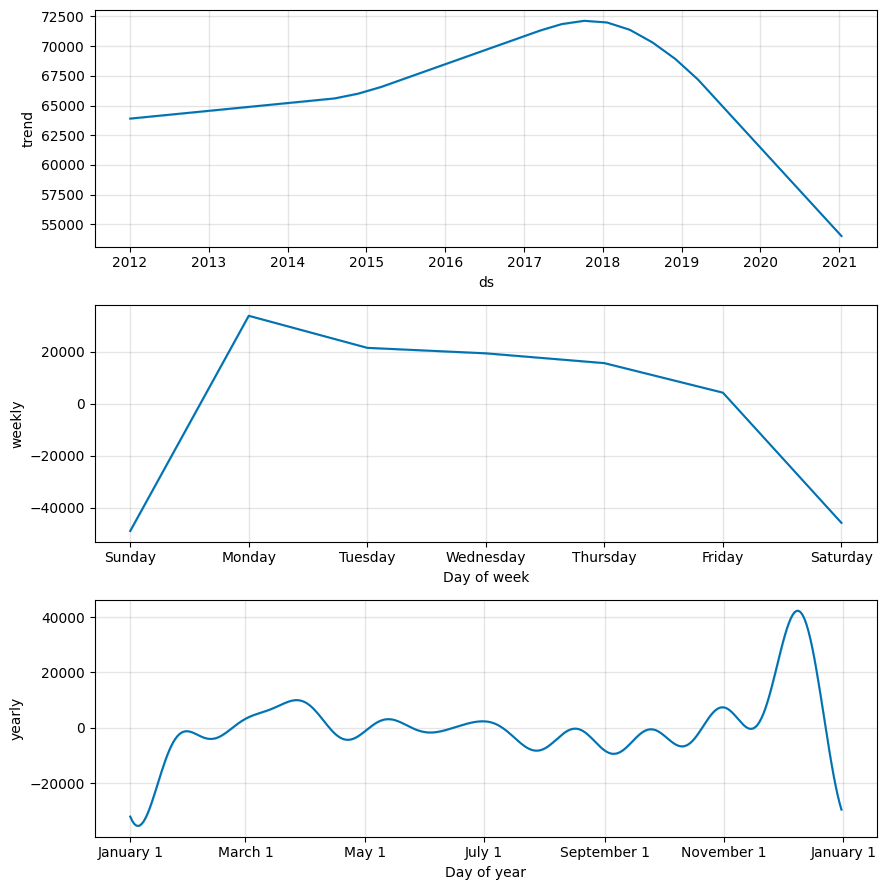

In [ ]:
# Python
fig2 = m.plot_components(forecast)